# Satellite Data Utilization from NASA Earthdata

* reference:
  - https://www.earthdata.nasa.gov/
  - https://www.earthdata.nasa.gov/learn/tutorials/spatial-temporal-advanced-filtering-nasa-earthdata-search
  - https://www.youtube.com/watch?v=QtfMlkd7kII
  - https://www.youtube.com/watch?v=iMbfxlNZRSk
  

# Satellite 

## NOAA GOES

* Spatial resolution: 500 m, 1000 m, 2000 m
* Temporal resolution: 5-15 minutes, geostationary 
* Spectral resolution: 16 bands ranging in wavelength from 0.402 µm to 12.49 µm

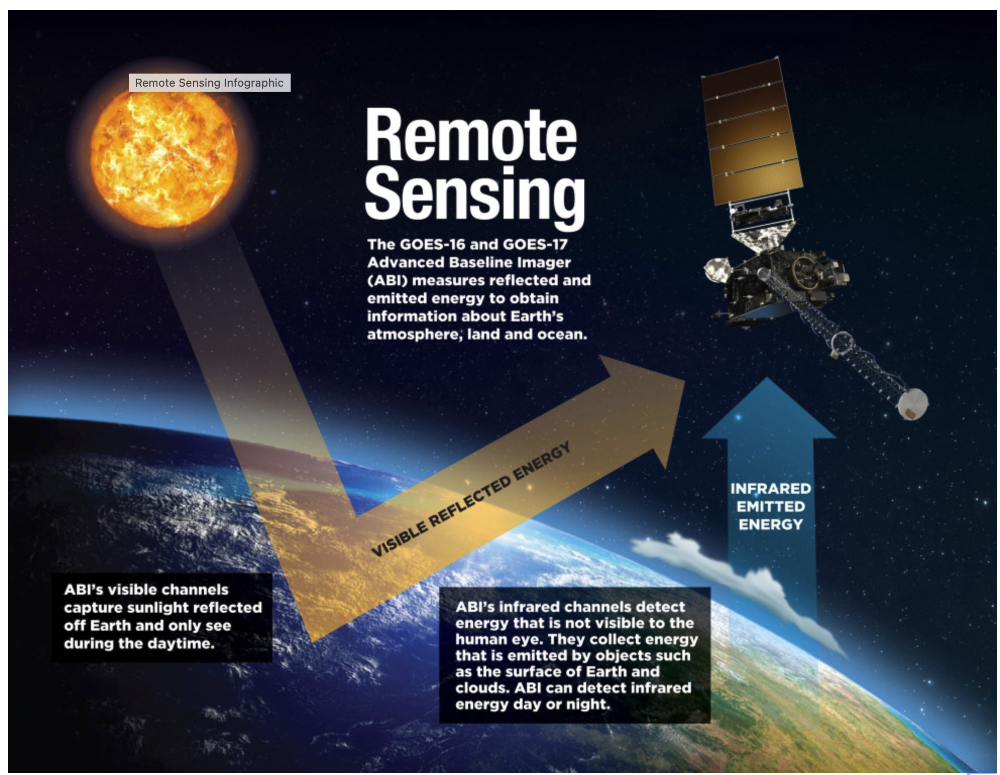


## VIIRS (Visible Infrared Imaging Radiometer Suite)

* Spatial resolution: 375 m, 750 m
* Temporal resolution: Daily
* Spectral resolution: 22 spectral bands ranging in wavelength from 0.402 µm to 12.49 µm

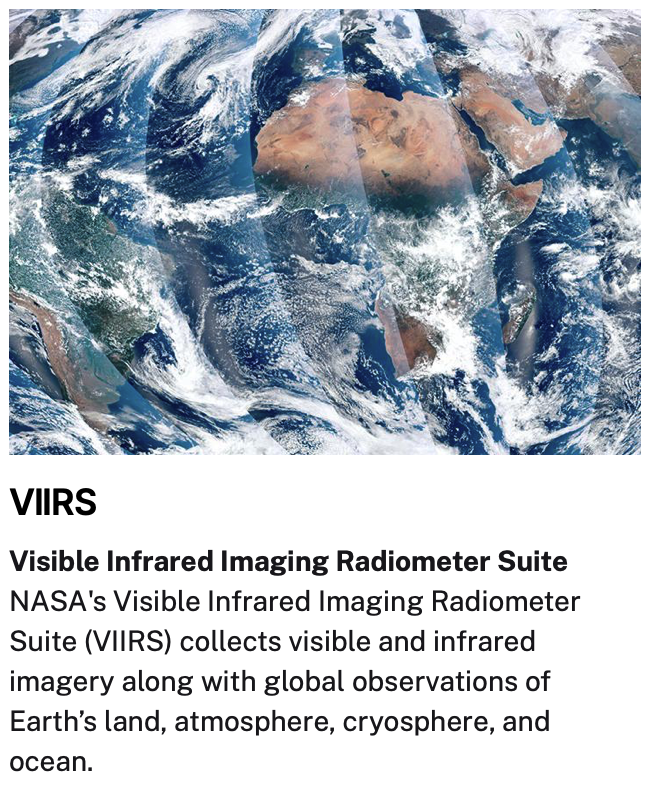

## MODIS (Moderate Resolution Imaging Spectroradiometer)

* Spatial resolution: 250 m, 500 m, 1000 m
* Temporal resolution: 1-2 days
* Spectral resolution: 36 spectral bands ranging in wavelength from 0.4 µm to 14.4 µm

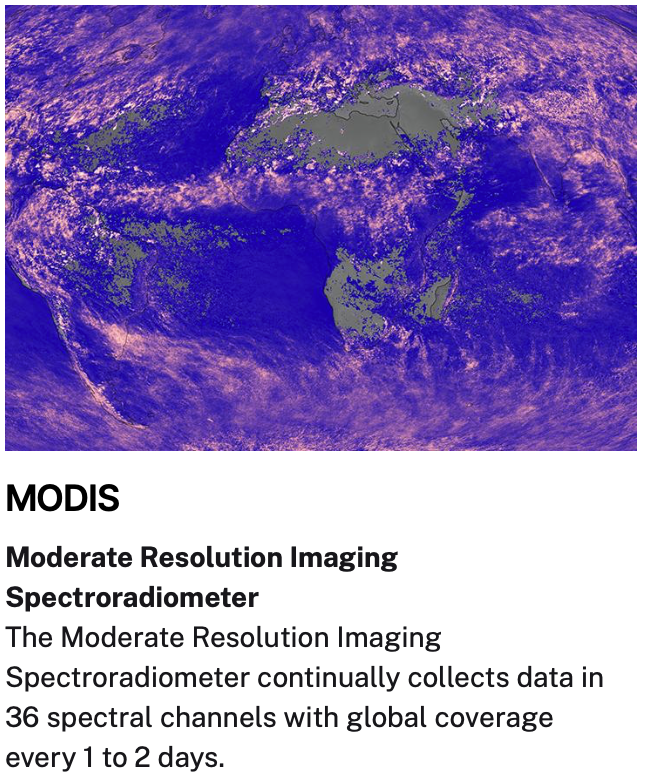


## Access Data 

### Register and Login to Earthdata

* https://urs.earthdata.nasa.gov/home

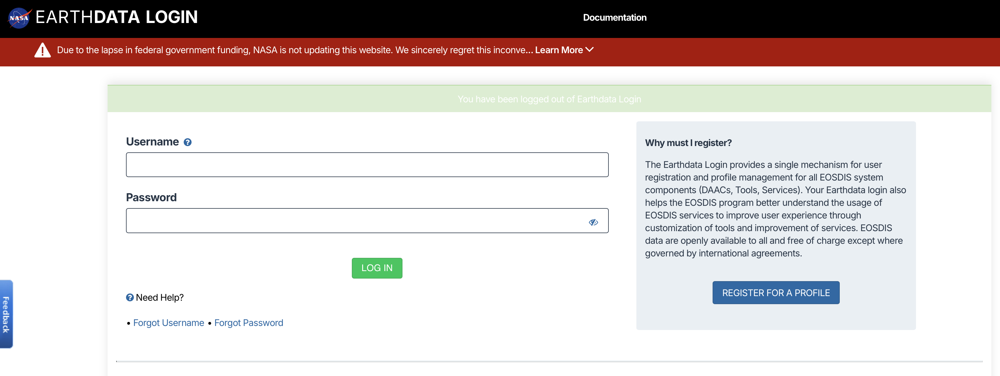

### Search data 
* https://search.earthdata.nasa.gov/home
* Select data and add them to 'myproject'
* Click 'myproject' and download the data by clicking the link directly or using download.sh.
(do not forget to run 'chmod 777 download.sh' before runnig the shell script.)

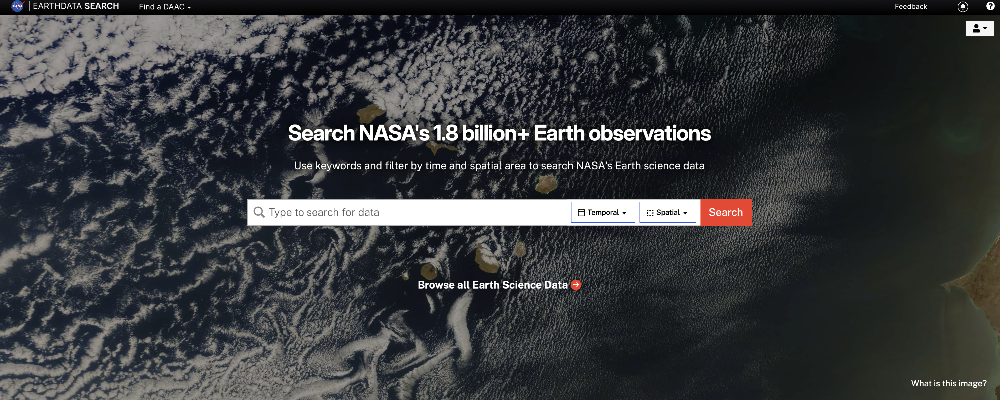

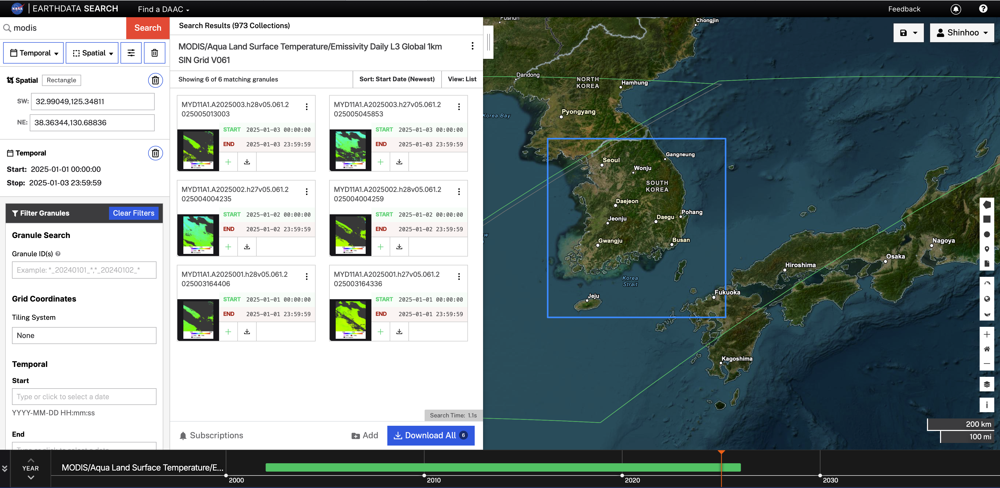

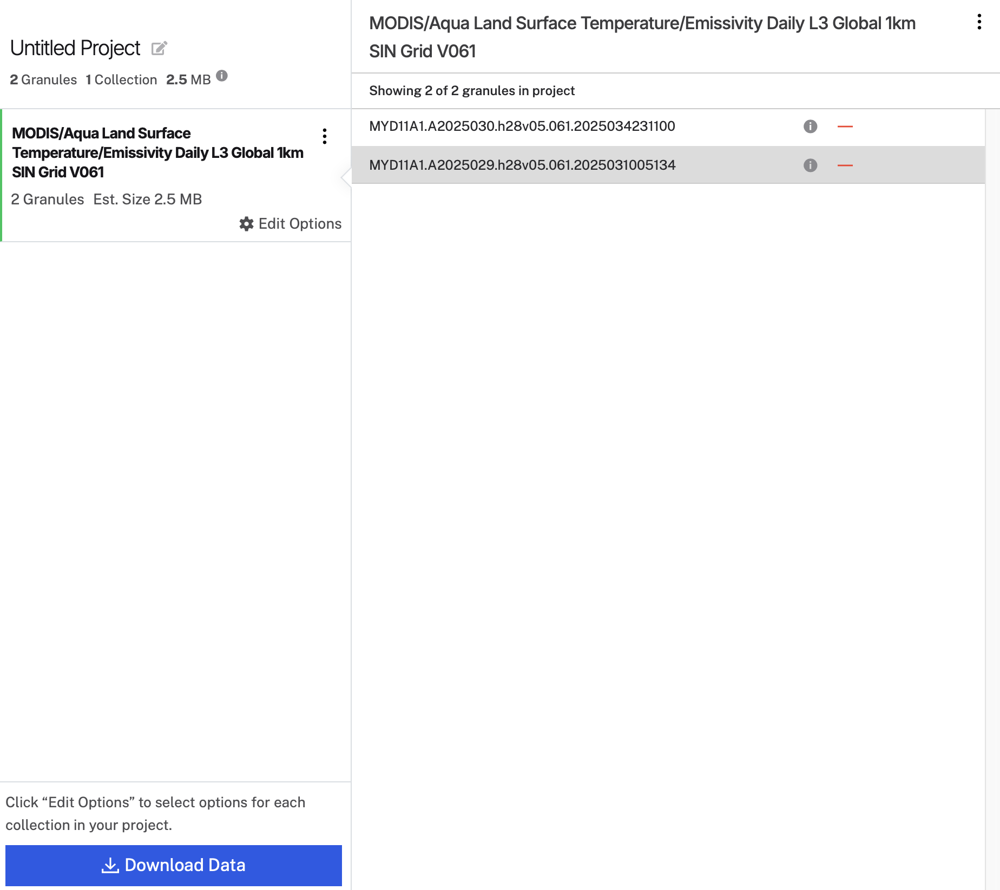

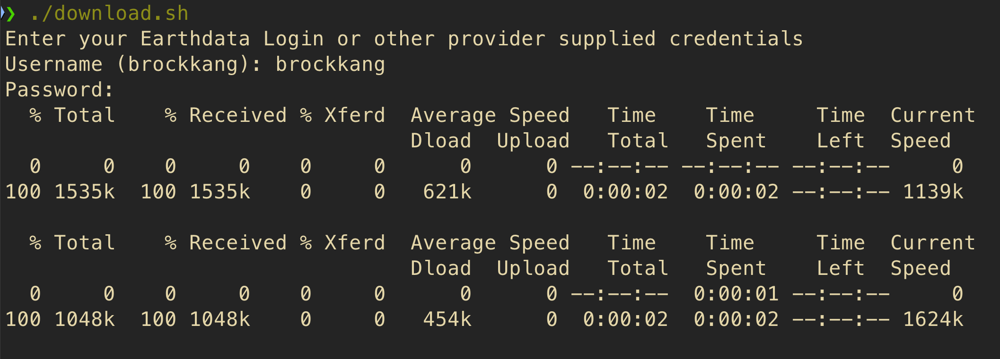

## To register a Python virtual environment as a Jupyter Kernel, follow these steps:

1. Activate your virtual environment

❯ source .venv/bin/activate

2. Register the virtual environment as a Jupyter kernel

❯ python -m ipykernel install --user --name .venv --display-name venv
Installed kernelspec .venv in /Users/pepc/Library/Jupyter/kernels/.venv

3. Verify the new kernel

❯ jupyter kernelspec list
Available kernels:
  python3    /Users/pepc/Teaching/410/.venv/share/jupyter/kernels/python3
  .venv      /Users/pepc/Library/Jupyter/kernels/.venv

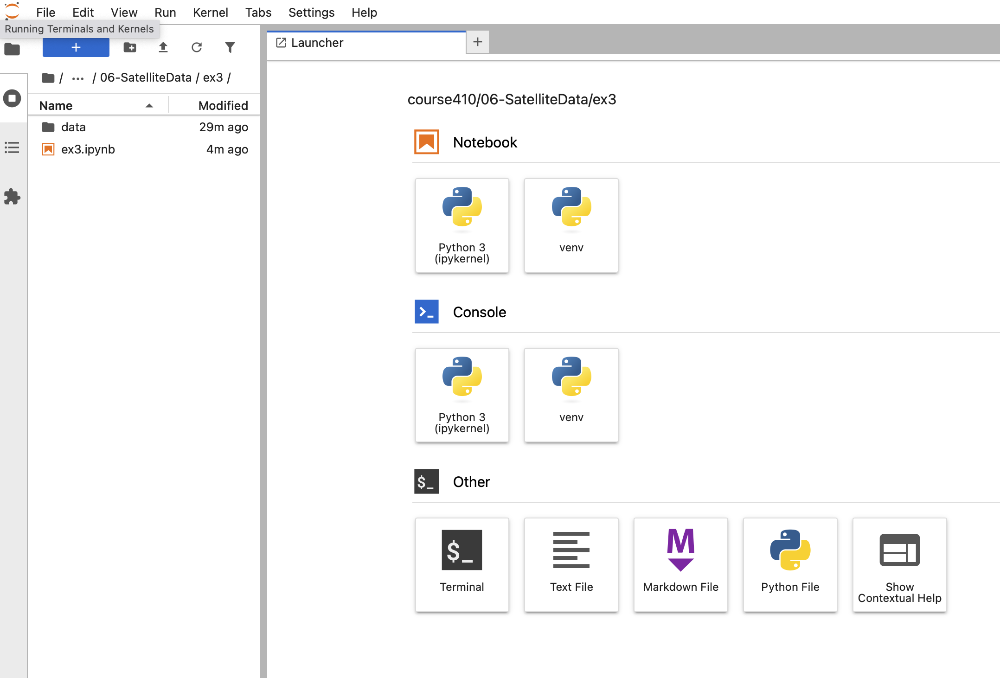


## Read Satellite Data


pyhdf is a Python library for reading and writing HDF4 files (Hierarchical Data Format version 4).
It provides a Python interface to the original HDF4 C library developed by the National Center for Supercomputing Applications (NCSA). Many older NASA satellite datasets—such as MODIS, MISR, and CERES—use this format (HDF-EOS2), so pyhdf is the main tool for working with them in Python.
                              

In [88]:
# SD: high-level “Scientific Dataset” interface (most commonly used)
from pyhdf.SD import SD, SDC 

# read HDF4 
ifile= 'MYD11A1.A2025029.h28v05.061.2025031005134.hdf'
data_path = '/Users/pepc/Teaching/410/course410/06-SatelliteData/ex3/data'
filename= os.path.join(data_path, ifile)
hdf = SD(filename, SDC.READ)

In [89]:
# show list of dataset
print(hdf.datasets())

{'LST_Day_1km': (('YDim:MODIS_Grid_Daily_1km_LST', 'XDim:MODIS_Grid_Daily_1km_LST'), (1200, 1200), 23, 0), 'QC_Day': (('YDim:MODIS_Grid_Daily_1km_LST', 'XDim:MODIS_Grid_Daily_1km_LST'), (1200, 1200), 21, 1), 'Day_view_time': (('YDim:MODIS_Grid_Daily_1km_LST', 'XDim:MODIS_Grid_Daily_1km_LST'), (1200, 1200), 21, 2), 'Day_view_angl': (('YDim:MODIS_Grid_Daily_1km_LST', 'XDim:MODIS_Grid_Daily_1km_LST'), (1200, 1200), 21, 3), 'LST_Night_1km': (('YDim:MODIS_Grid_Daily_1km_LST', 'XDim:MODIS_Grid_Daily_1km_LST'), (1200, 1200), 23, 4), 'QC_Night': (('YDim:MODIS_Grid_Daily_1km_LST', 'XDim:MODIS_Grid_Daily_1km_LST'), (1200, 1200), 21, 5), 'Night_view_time': (('YDim:MODIS_Grid_Daily_1km_LST', 'XDim:MODIS_Grid_Daily_1km_LST'), (1200, 1200), 21, 6), 'Night_view_angl': (('YDim:MODIS_Grid_Daily_1km_LST', 'XDim:MODIS_Grid_Daily_1km_LST'), (1200, 1200), 21, 7), 'Emis_31': (('YDim:MODIS_Grid_Daily_1km_LST', 'XDim:MODIS_Grid_Daily_1km_LST'), (1200, 1200), 21, 8), 'Emis_32': (('YDim:MODIS_Grid_Daily_1km_LST

In [90]:
# read Land Surface Temperature
sds = hdf.select("LST_Day_1km")
arr = sds[:]
arr

array([[    0,     0,     0, ...,     0,     0,     0],
       [    0,     0,     0, ...,     0,     0,     0],
       [    0,     0,     0, ...,     0,     0,     0],
       ...,
       [14375, 14366, 14372, ...,     0,     0,     0],
       [14378, 14378, 14376, ...,     0,     0,     0],
       [14361, 14372, 14373, ...,     0,     0,     0]],
      shape=(1200, 1200), dtype=uint16)

In [91]:
attrs = sds.attributes()
attrs

{'long_name': 'Daily daytime 1km grid Land-surface Temperature',
 'units': 'K',
 'Number Type': 'uint16',
 'valid_range': [7500, 65535],
 '_FillValue': 0,
 'LST': 'LST data * scale_factor',
 'scale_factor': 0.02,
 'scale_factor_err': 0.0,
 'add_offset_err': 0.0,
 'calibrated_nt': 5}

In [92]:
# scaling
import numpy as np
scale = attrs.get('scale_factor', 0.02)
offset = attrs.get('add_offset', 0.0)
fill   = attrs.get('_FillValue')
lst = np.where(arr == fill, np.nan, arr * scale + offset)
lst

array([[   nan,    nan,    nan, ...,    nan,    nan,    nan],
       [   nan,    nan,    nan, ...,    nan,    nan,    nan],
       [   nan,    nan,    nan, ...,    nan,    nan,    nan],
       ...,
       [287.5 , 287.32, 287.44, ...,    nan,    nan,    nan],
       [287.56, 287.56, 287.52, ...,    nan,    nan,    nan],
       [287.22, 287.44, 287.46, ...,    nan,    nan,    nan]],
      shape=(1200, 1200))

In [87]:
#  Convert to Celsius: [K] to [C]
lst_c = lst - 273.15
lst_c


array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]], shape=(1200, 1200))

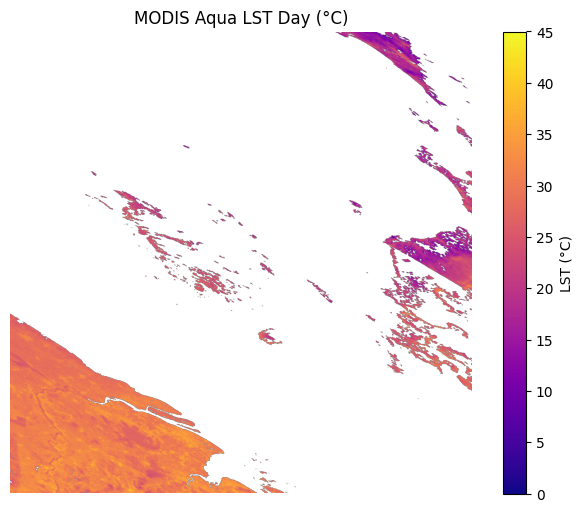

In [37]:
import matplotlib.pyplot as plt
plt.figure(figsize=(8,6))
plt.imshow(lst_c, cmap='plasma', vmin=0, vmax=45)
plt.title('MODIS Aqua LST Day (°C)')
plt.colorbar(label='LST (°C)')
plt.axis('off')
plt.show()

## Attach geographic coordinates (Lat/Lon)

In [93]:
import os, numpy as np
import re
import rasterio
from pyproj import CRS, Transformer

# read HDF4 
ifile= 'MYD11A1.A2025029.h28v05.061.2025031005134.hdf'
data_path = '/Users/pepc/Teaching/410/course410/06-SatelliteData/ex3/data'
filename= os.path.join(data_path, ifile)
hdf = SD(filename, SDC.READ)

# scaling
scale = attrs.get('scale_factor', 0.02)
offset = attrs.get('add_offset', 0.0)
fill   = attrs.get('_FillValue')
lst = np.where(arr == fill, np.nan, arr * scale + offset)

#  Convert to Celsius: [K] to [C]
lst_c = lst - 273.15

# Upper-left coordinate of a tile in terms of (h,v)
h = int(re.search(r'h(\d{2})v(\d{2})', ifile).group(1))
v = int(re.search(r'h(\d{2})v(\d{2})', ifile).group(2))
print('h={}, v={}'.format(h,v))

# MODIS sinusoidal parameters
R = 6371007.181  # m (MODIS sphere)
pixel = 926.625433055833   # 1km product pixel size (m)
tile_px = 1200             # 1200 x 1200 pixels per tile
tile_size = pixel * tile_px  # 1,111,950.519667 m

# global range (MODIS tiling)
xmin_global, ymax_global = -20015109.354, 10007554.677

# (upper-left) coordinate
x0 = xmin_global + h * tile_size
y0 = ymax_global - v * tile_size

print('x0={}, y0={}'.format(x0,y0))

# center of coorinates (행 j, 열 i)
w = hgt = tile_px; hgt = tile_px
i, j = np.meshgrid(np.arange(tile_px), np.arange(tile_px))
x = x0 + (i + 0.5) * pixel
y = y0 - (j + 0.5) * pixel

# sinusoidal -> lon/lat
# Transforming MODIS pixel coordinates (x, y in meters, sinusoidal projection) into standard geographic coordinates (longitude, latitude in degrees, EPSG:4326)
crs_sinu = CRS.from_proj4(f"+proj=sinu +R={R} +nadgrids=@null +wktext")
tfm = Transformer.from_crs(crs_sinu, "EPSG:4326", always_xy=True)
lon, lat = tfm.transform(x, y)

print('min(lat)={}, max(lat)={}'.format(np.min(lat), np.max(lat)) )
print('min(lon)={}, max(lon)={}'.format(np.min(lon), np.max(lon)) )

h=28, v=5
x0=11119505.19667599, y0=4447802.078665001
min(lat)=30.004166663954233, max(lat)=39.995833329726615
min(lon)=115.47971392449173, max(lon)=143.5806015501603


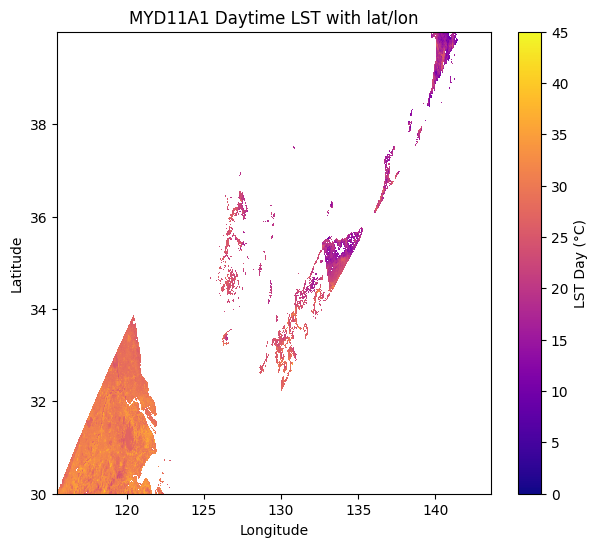

In [77]:
plt.figure(figsize=(7,6))
plt.pcolormesh(lon, lat, lst_c, shading='auto', cmap='plasma', vmin=0, vmax=45)
plt.colorbar(label='LST Day (°C)')
plt.xlabel('Longitude'); plt.ylabel('Latitude')
plt.title('MYD11A1 Daytime LST with lat/lon')
plt.show()